# Image Translation Pipeline Test Notebook

This notebook explores the best pipeline for image reconstruction, through a series of experiments.

## Setup

In [1]:
OLLAMA_URL = "http://localhost:11434"   # Feel free to change if your Ollama port is different
MODEL = "qwen2.5vl:32b"                 # Our approach is tested with and works best with Qwen2.5-VL 32B.

!ollama pull $MODEL
!ollama serve

pulling manifest ⠋ pulling manifest ⠙ pulling manifest ⠹ pulling manifest ⠸ pulling manifest ⠼ pulling manifest ⠴ pulling manifest 
pulling 043a363c6ca3: 100% ▕██████████████████▏  21 GB                         
pulling a242d8dfdc8f: 100% ▕██████████████████▏  487 B                         
pulling 75357d685f23: 100% ▕██████████████████▏   28 B                         
pulling 832dd9e00a68: 100% ▕██████████████████▏  11 KB                         
pulling 52d2a7aa3a38: 100% ▕██████████████████▏   23 B                         
pulling 61b48efc2682: 100% ▕██████████████████▏  568 B                         
verifying sha256 digest 
writing manifest 
success 
Error: listen tcp 127.0.0.1:11434: bind: Di norma è consentito un solo utilizzo di ogni indirizzo di socket (protocollo/indirizzo di rete/porta).


In [ ]:
!git clone https://huggingface.co/Qwen/Qwen-Image-Edit-2509 ./models/Qwen-Image-2509

^C


Cloning into './models/Qwen-Image-2509'...
Updating files:  71% (25/35)
Updating files:  74% (26/35)
Updating files:  77% (27/35)
Updating files:  80% (28/35)
Updating files:  82% (29/35)
Updating files:  85% (30/35)
Updating files:  88% (31/35)
Updating files:  91% (32/35)
Updating files:  94% (33/35)
Updating files:  97% (34/35)
Updating files: 100% (35/35)
Updating files: 100% (35/35), done.
Filtering content:  18% (2/11)
Filtering content:  18% (2/11), 1.54 GiB | 64.81 MiB/s
Filtering content:  27% (3/11), 1.54 GiB | 64.81 MiB/s
Filtering content:  27% (3/11), 1.77 GiB | 75.31 MiB/s
Filtering content:  36% (4/11), 1.77 GiB | 75.31 MiB/s
Filtering content:  45% (5/11), 1.77 GiB | 75.31 MiB/s
Filtering content:  45% (5/11), 3.36 GiB | 87.42 MiB/s
Filtering content:  54% (6/11), 3.36 GiB | 87.42 MiB/s
Filtering content:  54% (6/11), 3.95 GiB | 23.00 MiB/s
Filtering content:  63% (7/11), 3.95 GiB | 23.00 MiB/s
Filtering content:  63% (7/11), 5.25 GiB | 1.50 MiB/s 
Filtering content:  7

In [2]:
%pip install git+https://github.com/huggingface/diffusers
%pip install -r requirements.txt
%pip install torch torchvision --index-url https://download.pytorch.org/whl/cu129

  Cloning https://github.com/huggingface/diffusers to c:\users\standard\appdata\local\temp\pip-req-build-8vvsj_g2
  Resolved https://github.com/huggingface/diffusers to commit a9e4883b6a937bfe9360663d198302ec0f0a204c
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'
Note: you may need to restart the kernel to use updated packages.


  Running command git clone --filter=blob:none --quiet https://github.com/huggingface/diffusers 'C:\Users\standard\AppData\Local\Temp\pip-req-build-8vvsj_g2'


Note: you may need to restart the kernel to use updated packages.
Looking in indexes: https://download.pytorch.org/whl/cu129
Note: you may need to restart the kernel to use updated packages.


In [2]:
import os
from PIL import Image, ImageDraw, ImageFilter
from typing import List
import torch
from ollama import chat
from ollama import ChatResponse
from diffusers import QwenImageEditPlusPipeline
import base64
import pprint
from io import BytesIO

### Utils

In [3]:
def polish_prompt_en(original_prompt: str, images: List[Image.Image]):
    base64_images = []
    for image in images:
        with BytesIO() as buffered:
            image.save(buffered, format="JPEG")
            base64_images.append(base64.b64encode(buffered.getvalue()).decode("utf8"))
    response: ChatResponse = chat(model=MODEL, messages=[
    {
        'role': 'user',
        'content':  f'''
        # Edit Instruction Rewriter
        You are a professional edit instruction rewriter. Your task is to generate a precise, concise, and visually achievable professional-level edit instruction based on the user-provided instruction and the image to be edited.  

        Please strictly follow the rewriting rules below:

        ## 1. General Principles
        - Keep the rewritten prompt **concise**. Avoid overly long sentences and reduce unnecessary descriptive language.  
        - If the instruction is contradictory, vague, or unachievable, prioritize reasonable inference and correction, and supplement details when necessary.  
        - Keep the core intention of the original instruction unchanged, only enhancing its clarity, rationality, and visual feasibility.  
        - All added objects or modifications must align with the logic and style of the edited input image’s overall scene.  

        ## 2. Task Type Handling Rules
        ### 1. Add, Delete, Replace Tasks
        - If the instruction is clear (already includes task type, target entity, position, quantity, attributes), preserve the original intent and only refine the grammar.  
        - If the description is vague, supplement with minimal but sufficient details (category, color, size, orientation, position, etc.). For example:  
            > Original: "Add an animal"  
            > Rewritten: "Add a light-gray cat in the bottom-right corner, sitting and facing the camera"  
        - Remove meaningless instructions: e.g., "Add 0 objects" should be ignored or flagged as invalid.  
        - For replacement tasks, specify "Replace Y with X" and briefly describe the key visual features of X.  

        ### 2. Text Editing Tasks
        - All text content must be enclosed in English double quotes `" "`. Do not translate or alter the original language of the text, and do not change the capitalization.  
        - **For text replacement tasks, always use the fixed template:**
            - `Replace "xx" to "yy"`.  
            - `Replace the xx bounding box to "yy"`.  
        - If the user does not specify text content, infer and add concise text based on the instruction and the input image’s context. For example:  
            > Original: "Add a line of text" (poster)  
            > Rewritten: "Add text \"LIMITED EDITION\" at the top center with slight shadow"  
        - Specify text position, color, and layout in a concise way.  

        ### 3. Human Editing Tasks
        - Maintain the person’s core visual consistency (ethnicity, gender, age, hairstyle, expression, outfit, etc.).  
        - If modifying appearance (e.g., clothes, hairstyle), ensure the new element is consistent with the original style.  
        - **For expression changes, they must be natural and subtle, never exaggerated.**  
        - If deletion is not specifically emphasized, the most important subject in the original image (e.g., a person, an animal) should be preserved.
            - For background change tasks, emphasize maintaining subject consistency at first.  
        - Example:  
            > Original: "Change the person’s hat"  
            > Rewritten: "Replace the man’s hat with a dark brown beret; keep smile, short hair, and gray jacket unchanged"  

        ### 4. Style Transformation or Enhancement Tasks
        - If a style is specified, describe it concisely with key visual traits. For example:  
            > Original: "Disco style"  
            > Rewritten: "1970s disco: flashing lights, disco ball, mirrored walls, colorful tones"  
        - If the instruction says "use reference style" or "keep current style," analyze the input image, extract main features (color, composition, texture, lighting, art style), and integrate them into the prompt.  
        - **For coloring tasks, including restoring old photos, always use the fixed template:** "Restore old photograph, remove scratches, reduce noise, enhance details, high resolution, realistic, natural skin tones, clear facial features, no distortion, vintage photo restoration"  
        - If there are other changes, place the style description at the end.

        ## 5. Rationality and Logic Checks
        - Resolve contradictory instructions: e.g., "Remove all trees but keep all trees" should be logically corrected.  
        - Add missing key information: if position is unspecified, choose a reasonable area based on composition (near subject, empty space, center/edges).  

        # Output Format Example
        "211 floors high skyscrape, majesticly dominating the crowded street below..."

        Prompt to be rewritten: {original_prompt}
        ''',
        "images": base64_images
    }
    ])
    return response['message']['content']

### Pipeline loading

In [4]:
pipeline = QwenImageEditPlusPipeline.from_pretrained("Qwen/Qwen-Image-Edit-2509")
print("Pipeline loaded.")

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/5 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/4 [00:00<?, ?it/s]

Pipeline loaded.


In [5]:
pipeline.to(torch.float32) # Inference in mixed precision (torch.bfloat16, raccomended for faster inference). However, if you are making inference through CPU, please use full precision (torch.float32)
pipeline.to("cpu")         # Change to "cpu" if CUDA is not supported by your machine. The inference will be slower.
pipeline.set_progress_bar_config(disable=False)

In [6]:
def generate_image(inputs, output_filename = "output_edit"):
    with torch.inference_mode():
        output = pipeline(**inputs)
        i = 0
        for output_image in output.images:
            output_image.save(f"{output_filename}_{i}.jpeg")
            i += 1
        print("Image generated (saved!)")
    return output_image

def make_inputs(images, prompt: str, guidance = 4.0, neg_prompt = " ", inf_steps = 50, gen_images = 1):
    return {
    "image": images,
    "prompt": prompt,
    "generator": torch.manual_seed(0),
    "true_cfg_scale": guidance,
    "negative_prompt": neg_prompt,
    "num_inference_steps": inf_steps,
    "num_images_per_prompt": gen_images
    }


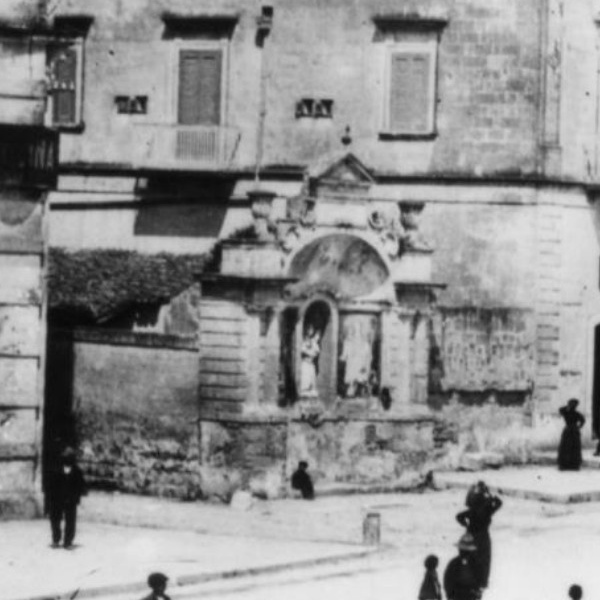

In [7]:
image_full = Image.open("assets/eustachian_monument.jpeg").convert("RGB")
image_roi = image_full.crop((200, 500, 800, 1100))
image_roi

---

## Test 1: Full image rotation

In [ ]:
images = [image_full]
prompt = polish_prompt_en("Rotate the main subject, so that it looks in front view.", images)
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs, "examples/output_fp_full")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


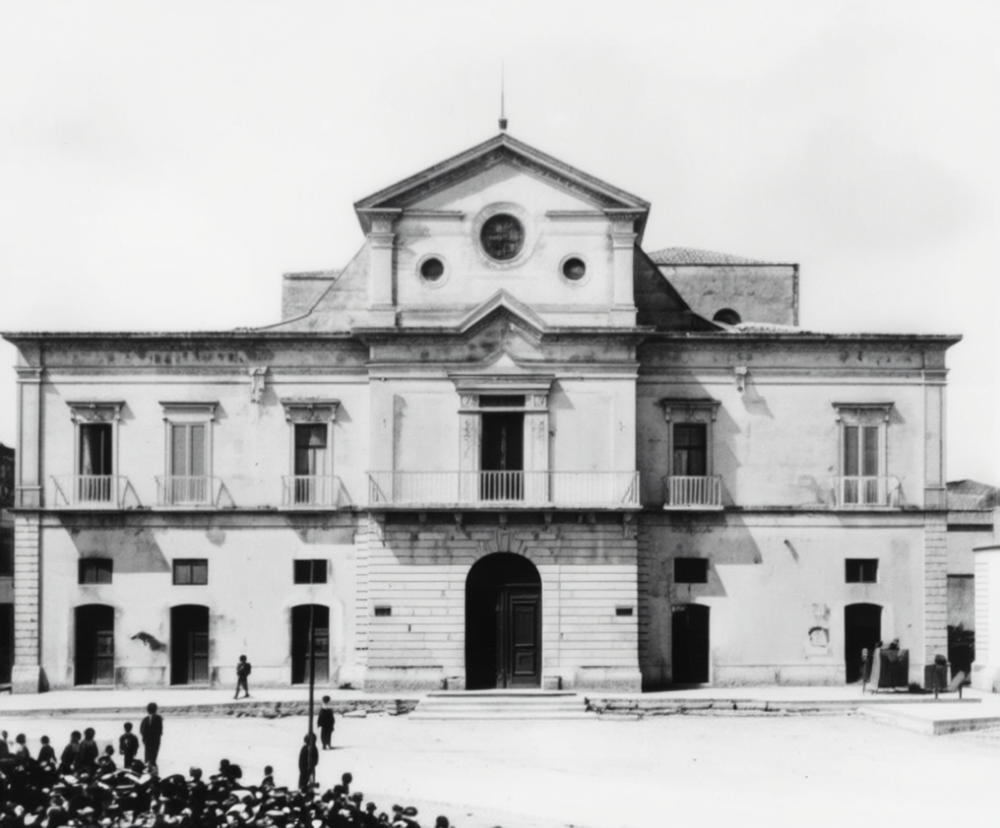

In [29]:
output_image

### On a ROI

In [30]:
images = [image_roi]
prompt = polish_prompt_en("Rotate the main subject, so that it looks in front view.", images)
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs,  "examples/output_fp_roi")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


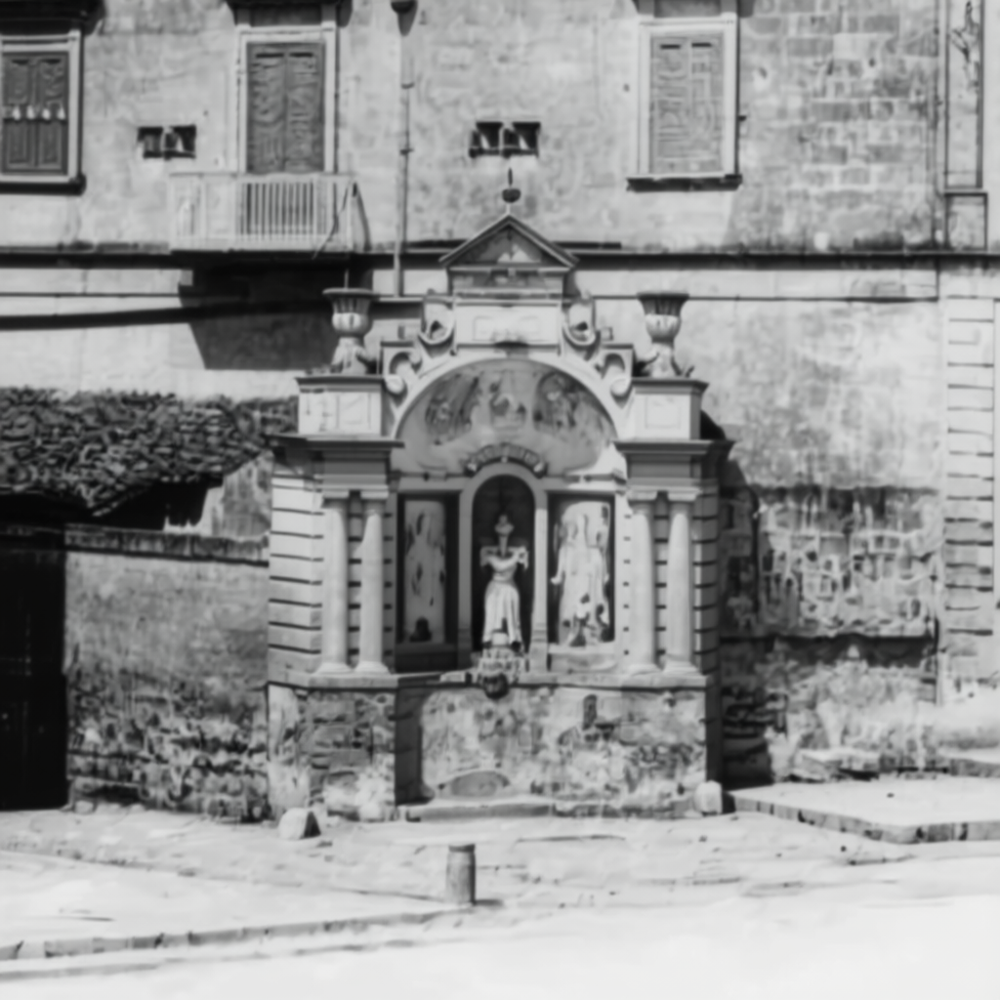

In [31]:
output_image

---
### Prompt enhancement

Full Image

In [32]:
images = [image_full]
prompt = polish_prompt_en("""
    Rotate the monument, so that its facade looks in front view.
    The monument is the small building on the left half of the image, containing three niches, with statues inside it.
    """, images)
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs, "examples/output_fp_full_better_prompt")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


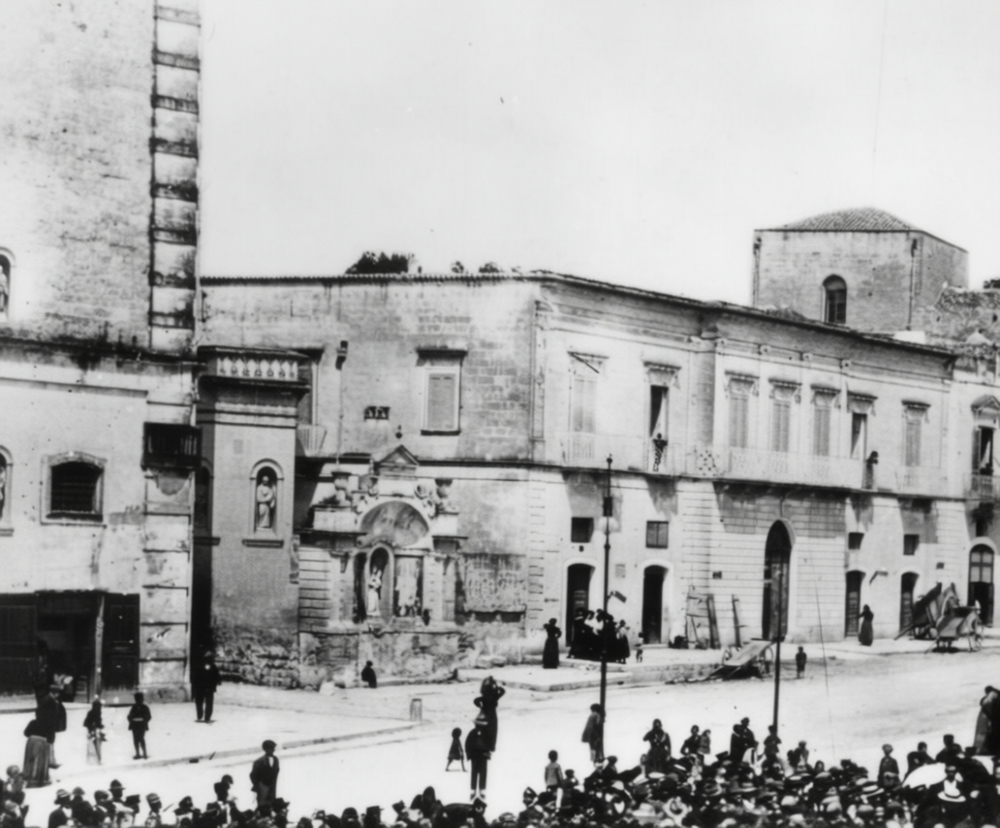

In [33]:
output_image

ROI

In [34]:
images = [image_roi]
prompt = polish_prompt_en("""
    Rotate the monument, so that its facade looks in front view.
    The monument is the small building, depicted in the center of the image.
    """, images)
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs, "examples/output_fp_roi_better_prompt")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


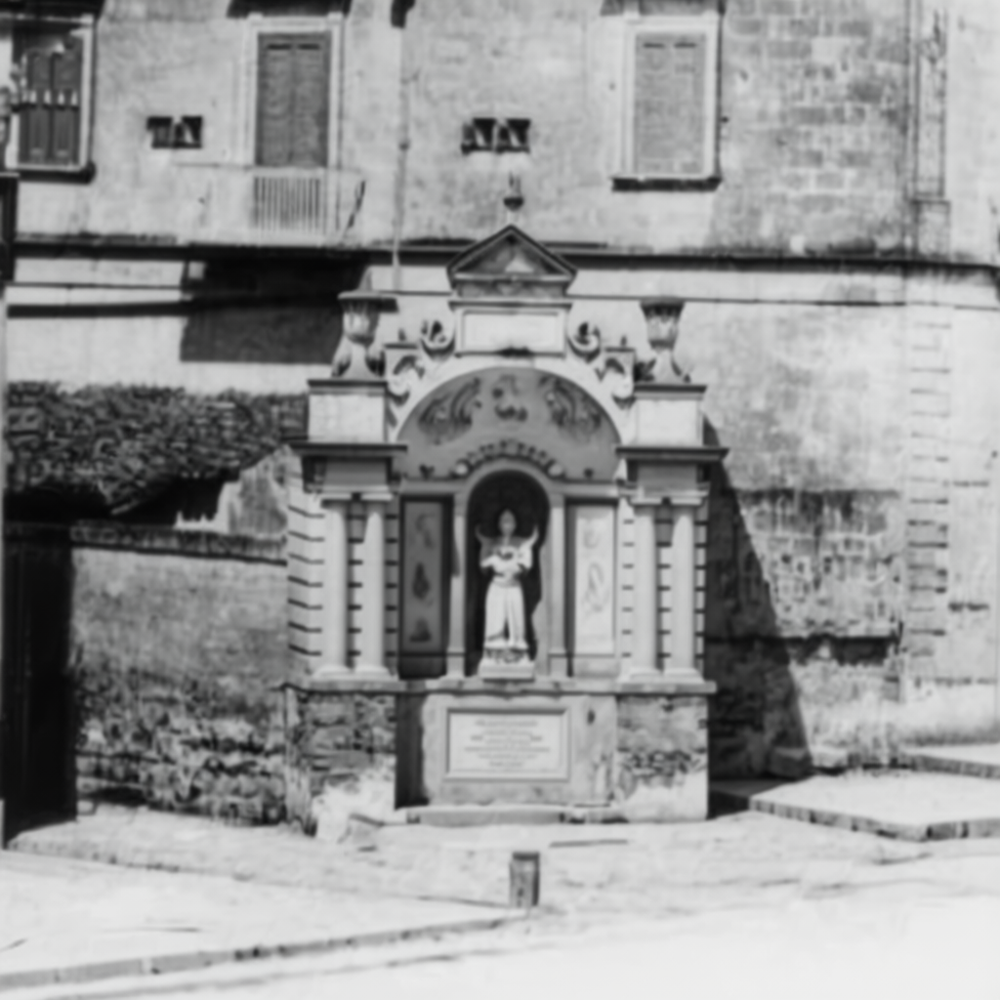

In [35]:
output_image

## Test 2: Pre-enhancing, then rotation

### Full Image

In [36]:
images = [image_full]
prompt = polish_prompt_en("Enhance the image details, so that the depicted images get more evident. Stay consistent with the original image style and color.", images)
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs,  "examples/output_fp_full_enhanced")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


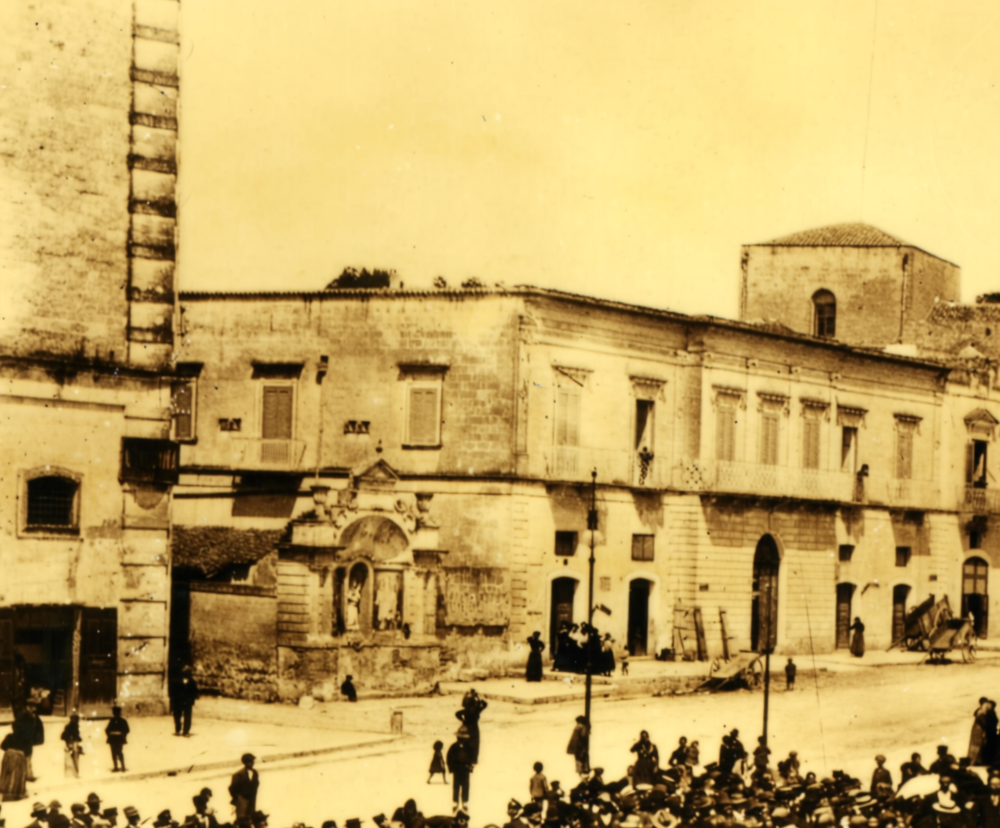

In [37]:
output_image

In [38]:
images = [output_image]
prompt = polish_prompt_en("Rotate the main subject, so that it looks in front view.", images)
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs,  "examples/output_fp_full_prenh")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


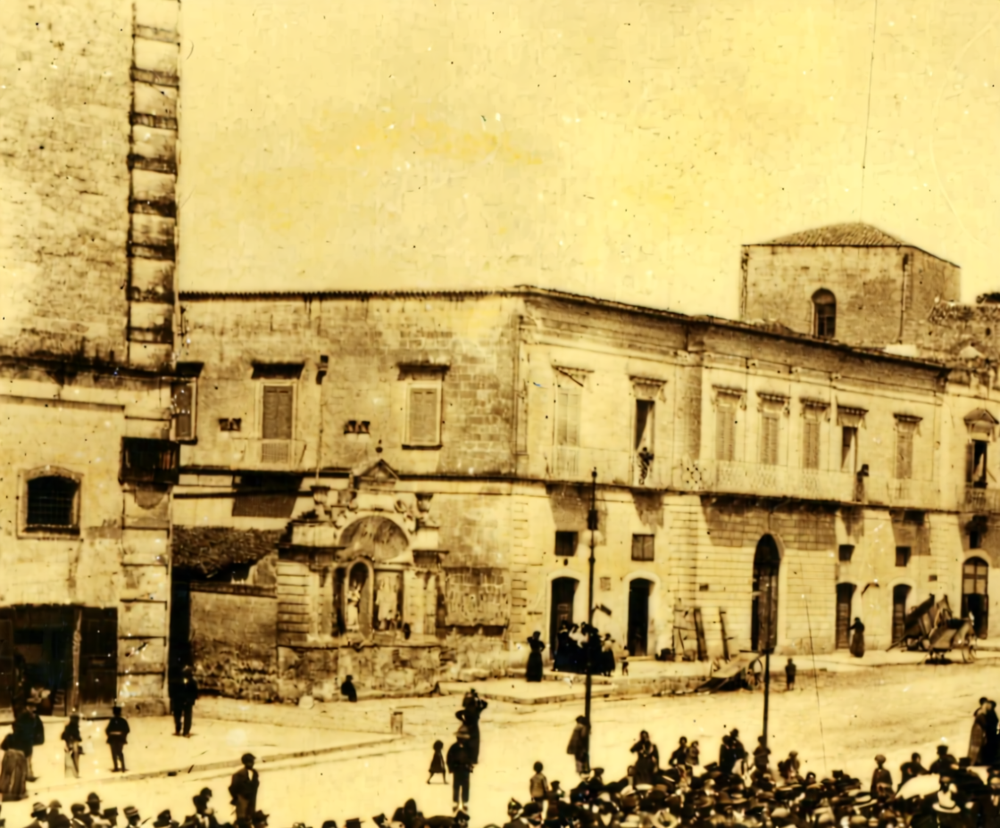

In [39]:
output_image

### ROI


In [40]:
images = [image_roi]
prompt = polish_prompt_en("Enhance the image details, so that the depicted images get more evident. Stay consistent with the original image style and color.", images)
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs,  "examples/output_fp_roi_enhanced")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


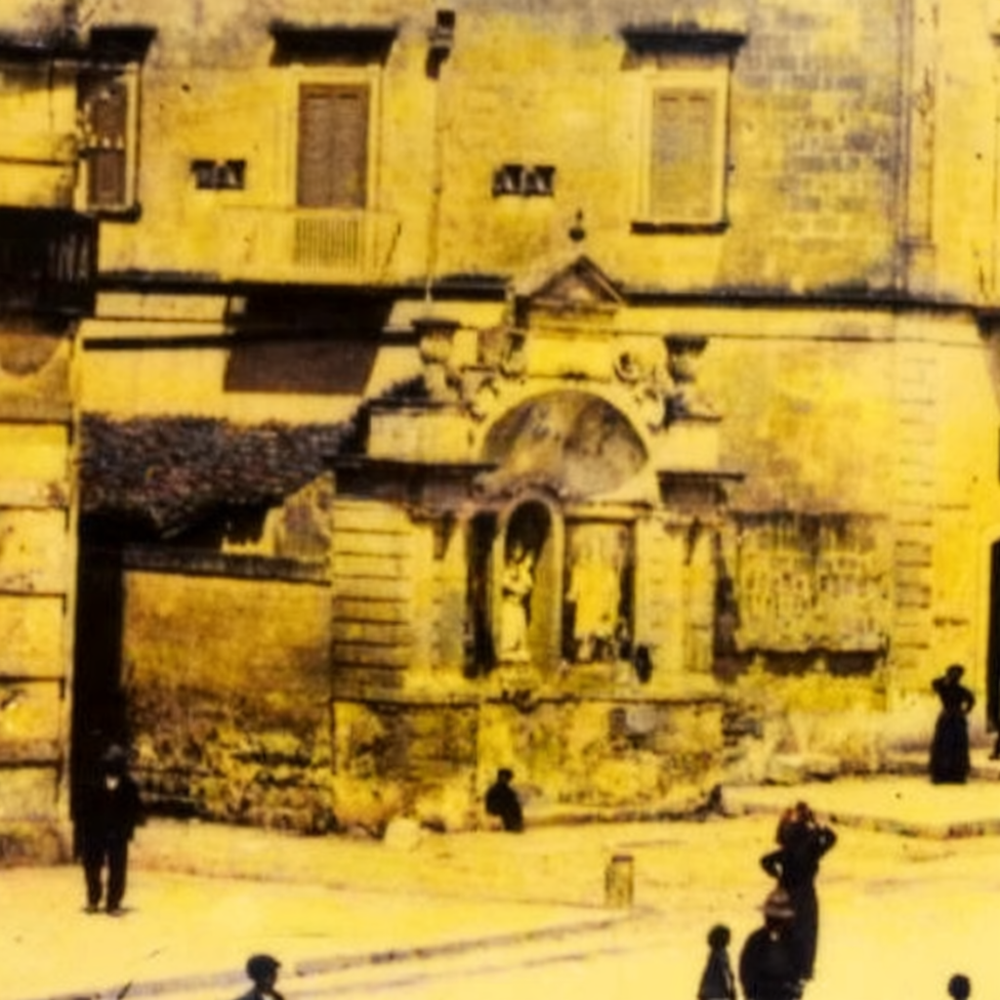

In [41]:
output_image

In [42]:
images = [output_image]
prompt = polish_prompt_en("Rotate the main subject, so that it looks in front view.", images)
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs,  "examples/output_fp_roi_prenh")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


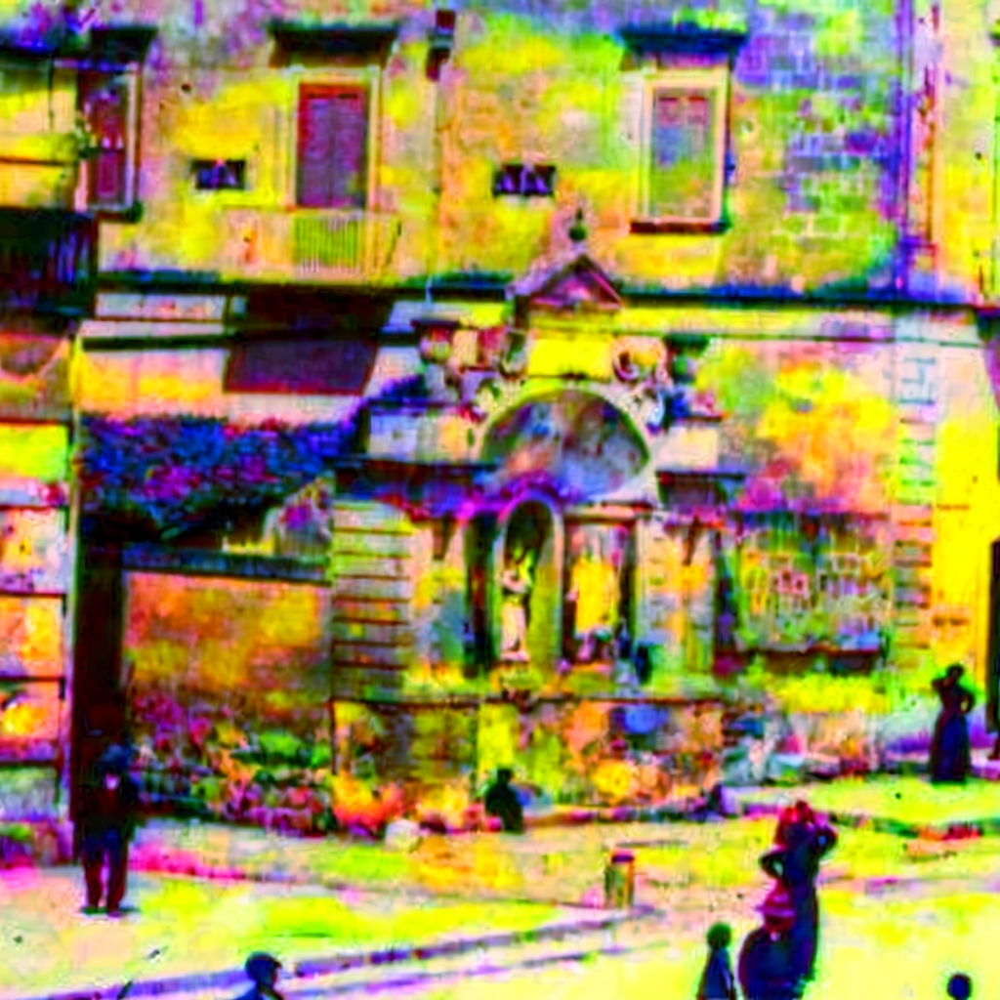

In [43]:
output_image

---

# Inpainting

Based on best results

## Test 1: All-at-once

In [65]:
images = [Image.open("examples/output_fp_roi_0.jpeg"), Image.open("assets/stEustace.jpg"), Image.open("assets/stVitus.jpeg")]
prompt = polish_prompt_en("""
    Given the image of the monument, put the statues inside its lateral niches.
    The statues need to be in the exact same style of the monument image.
    Preserve each image's detail.
    Do not change the statues' faces features.
""", images)
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs, f"examples/inpaint_oao")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


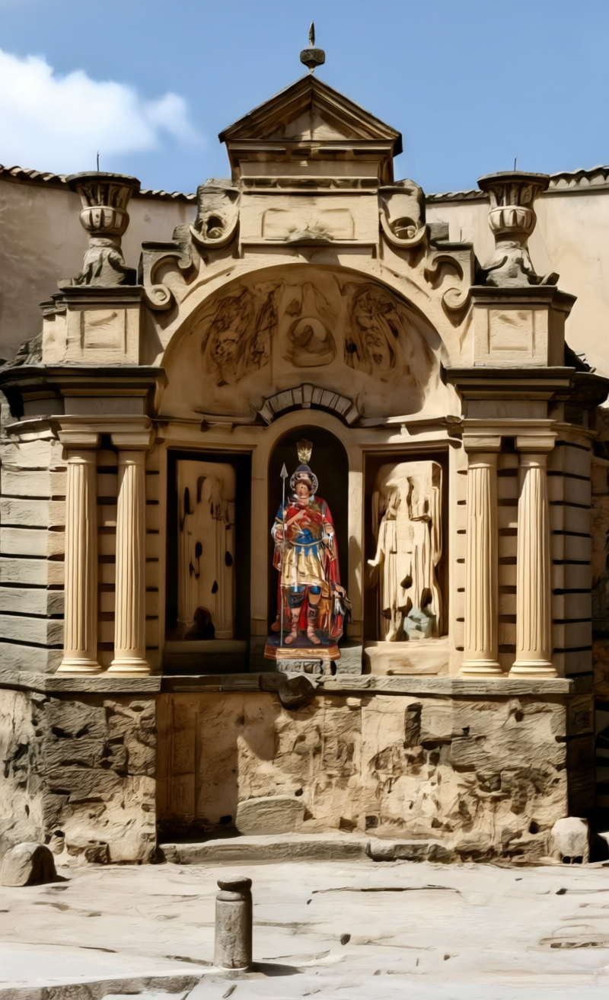

In [66]:
output_image

# Test 2: One at time

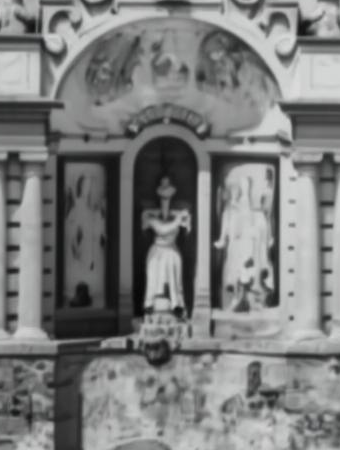

In [8]:
rotated = Image.open("examples/output_fp_roi_0.jpeg")
rotated_roi = rotated.crop((350, 350, 690, 800))
rotated_roi

In [ ]:
images = [rotated_roi]
prompt = polish_prompt_en("""Put a little statue of Holy Mary
                           standing and holding a blessing Baby Jesus, inside the central niche. Be sure to match proportions.
                          **Be sure to put Holy Mary below the little arc.**
                          Leave the background untouched.
                          Keep the features of both Holy Mary and Baby Jesus' faces well defined.
                          Make the image black and white.""", images)
neg_prompt = polish_prompt_en("Do not enlarge nor shrink the niche. Scale the size of Holy Mary instead. Do not put Holy Mary below the big arc", images)
print(prompt, neg_prompt, sep="\n")
inputs = make_inputs(images, prompt, neg_prompt=neg_prompt)
output_image = generate_image(inputs, "examples/inpaint_holymary")

"Add a small statue of Holy Mary standing and holding a blessing Baby Jesus inside the central niche, ensuring the proportions match the surrounding architecture. Position Holy Mary below the little arc. Keep the background unchanged and maintain clear, well-defined facial features for both Holy Mary and Baby Jesus. Ensure the image remains black and white."
"Scale the statue of Holy Mary to a smaller size while keeping the niche unchanged. Ensure Holy Mary is not positioned below the large arch."


  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


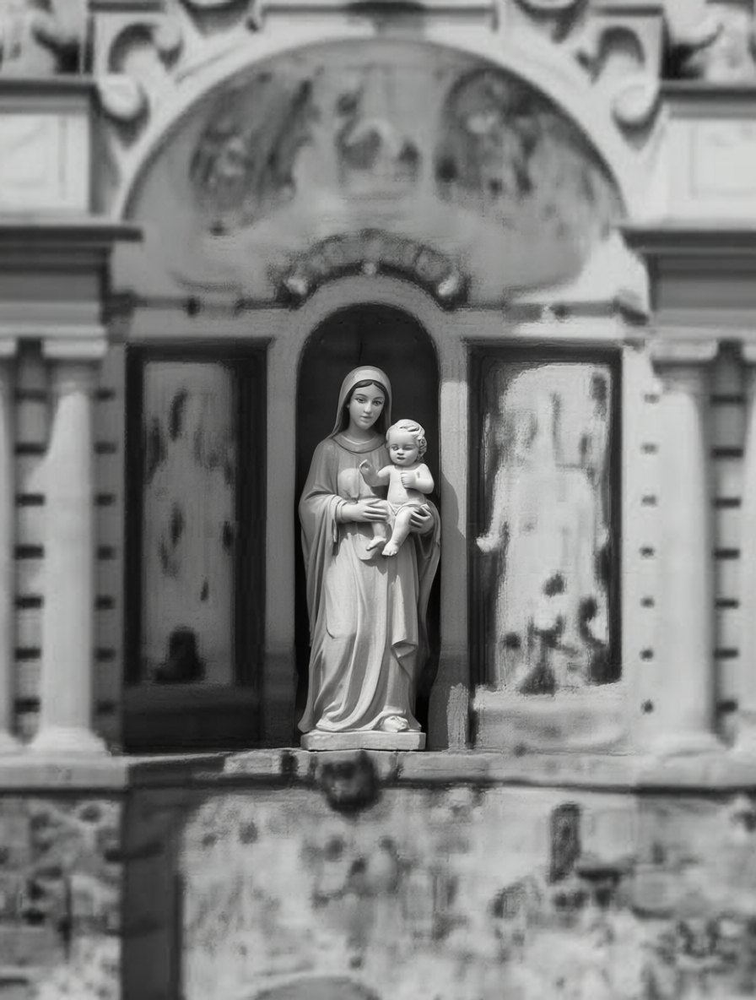

In [50]:
output_image

In [11]:
images = [Image.open("examples/inpaint_holymary_0.jpeg"), Image.open("assets/stEustace.jpg")]
prompt = polish_prompt_en('''Add a statue of saint Eustace to the right of the central niche, using the image of the saint as a reference.
                           Match the style of the image.
                           Leave the central niche untouched. Keep face features well defined. Make the image black and white''', images)
neg_prompt = polish_prompt_en("Do not enlarge nor shrink the niche. Do not edit the background. Do not crop the image. Do not make the statue too big or too small.", images)
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs, f"examples/inpaint_eustace")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


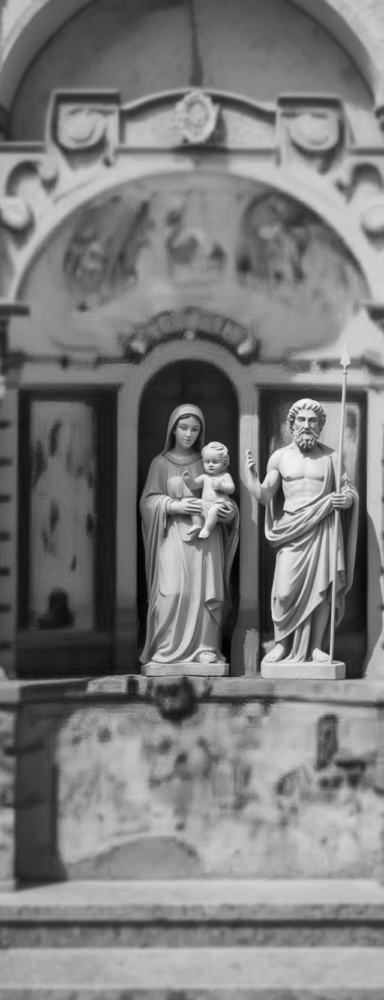

In [12]:
output_image

In [13]:
images = [output_image, Image.open("assets/stVitus.jpeg")]
prompt = polish_prompt_en('''Add a statue of saint Vitus to the left of the central niche, using the image of the saint as a reference. 
                           Match the image style.
                           Be sure to match proportions.
                           Leave the central niche untouched.
                           Keep face features well defined. Make the image black and white''', images)
inputs = make_inputs(images, prompt)
neg_prompt = polish_prompt_en("Do not put saint Vitus higher or lower with respect to other statues. Do not put the statue outside the monument. Do not put the statue on the side pillars, nor on the ground.", images)
output_image = generate_image(inputs, f"examples/inpaint_vitus")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


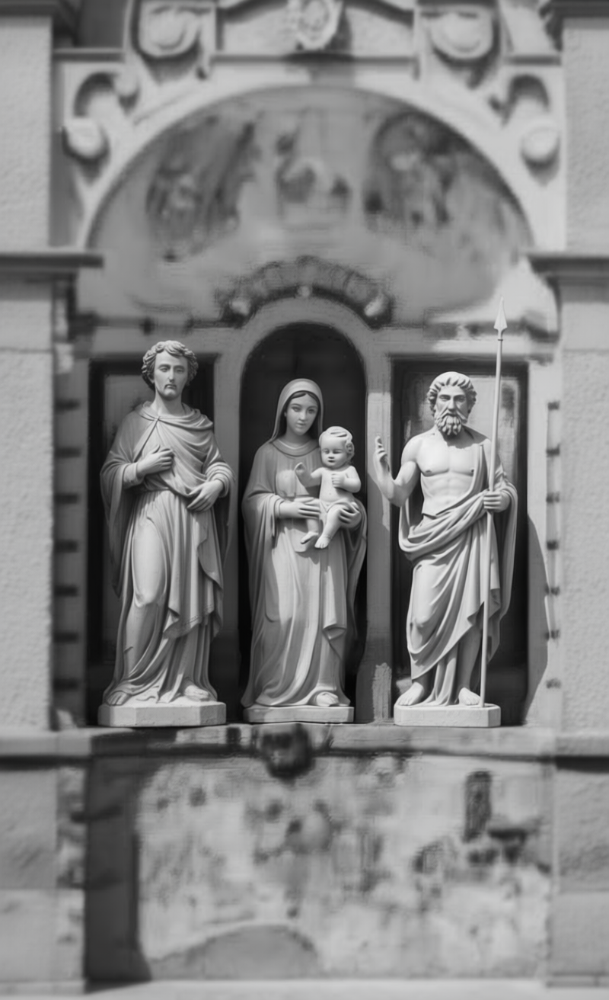

In [14]:
output_image

## Style and Environment refinement

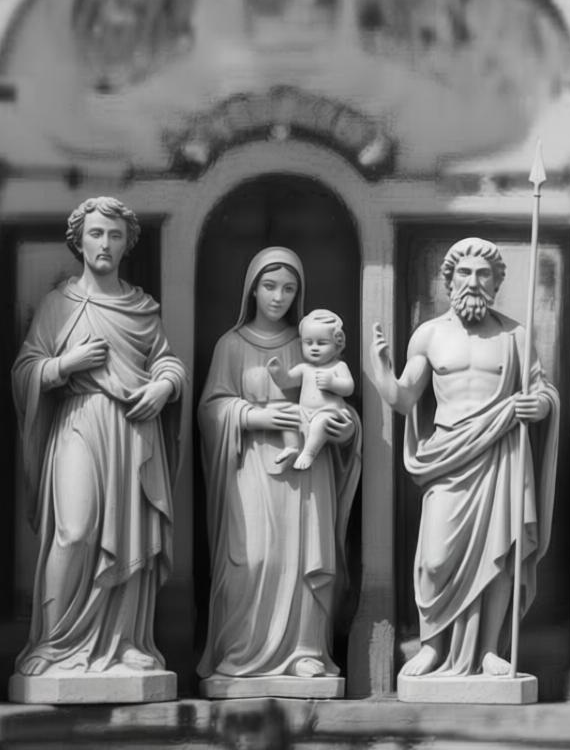

In [16]:
inpainted = Image.open("examples/inpaint_vitus_0.jpeg")
inpainted_roi = inpainted.crop((120, 250, 690, 1000))
inpainted_roi

In [17]:
images = [rotated, inpainted_roi]
prompt = polish_prompt_en("""
    Put the three saints inside the frontal view of the monument.
    Generate a scene similar to the first image, including the monument and the details in it.
    Keep the image in black and white.
    Be sure to match proportions.
    Be sure to generate consistent face features.
""", images)
neg_prompt = polish_prompt_en("Do not edit the monument. Do not change the statues features or look. Do not remove any of the statues. Do not put statues out of the monument.", images)
inputs = make_inputs(images, prompt, neg_prompt=neg_prompt)
output_image = generate_image(inputs, f"examples/env_refinement")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


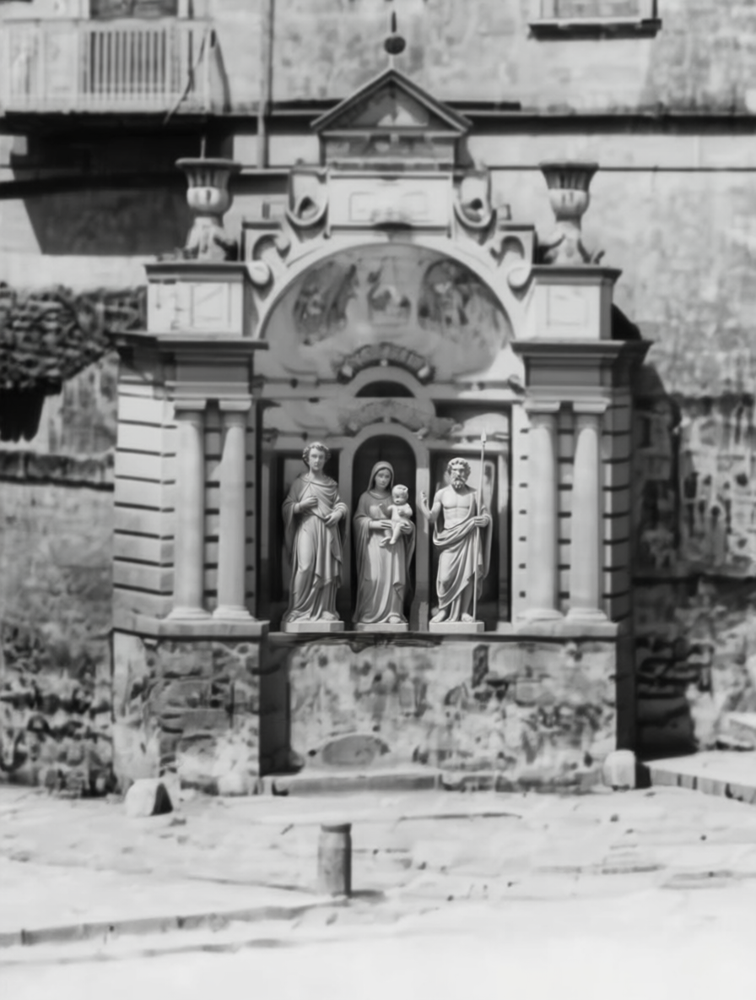

In [18]:
output_image

In [68]:
images = [output_image]
prompt = polish_prompt_en("Colorize the image.", images)
#neg_prompt = polish_prompt_en("Do not edit the monument. Do not change the statues features or look. Do not remove any of the statues.", images)
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs, f"examples/env_refinement")

  0%|          | 0/50 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
output_image